# Full Dataset Plots
##### These are all of the preliminary plots of the full datasets - Bhoomika

In [180]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
import plotly.graph_objects as go
import operator as op
from scipy.interpolate import interp2d

In [181]:
NYTSdf = pd.read_csv("EDITEDNYTS16_22.csv")
NYTSNumbersdf = pd.read_csv("EDITEDNYTS16_22_Numbers.csv")
NYTSNumbersdf.apply(pd.to_numeric)

C:\Users\bhoom\AppData\Local\Temp\ipykernel_26764\3230394758.py:1: DtypeWarning:

Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.



,Unnamed: 0,Year,Gender,Grade_of_Student,E_Cig_Ever_Used,E_Cig_Days_Used,E_Cig_Last_Used,E_Cig_Curiousity,E_Cig_Try,E_Cig_Try_Next_Year,...,Cigarette_Curiosity,Cigarette_Try,Cigarette_Try_Next_Year,The_Real_Cost,Any_Tobacco_Craving,Attempt_Quitting_Tobacco,Are_Tobacco_Products_Harmful,E_Cig_Promotions_Internet,Tobacco_Promotions_Internet,Cigarette_Last_Used
0,0,2022,2.0,2.0,2.0,NaN,NaN,4.0,4.0,4.0,...,4.0,4.0,4.0,3.0,NaN,NaN,2.0,3.0,3.0,NaN
1,1,2022,2.0,2.0,2.0,NaN,NaN,3.0,2.0,3.0,...,4.0,4.0,4.0,1.0,NaN,NaN,2.0,5.0,5.0,NaN
2,2,2022,1.0,2.0,2.0,NaN,NaN,4.0,4.0,4.0,...,4.0,4.0,4.0,2.0,NaN,NaN,4.0,2.0,2.0,NaN
3,3,2022,1.0,2.0,2.0,NaN,NaN,3.0,3.0,3.0,...,NaN,NaN,NaN,2.0,NaN,NaN,2.0,3.0,3.0,NaN
4,4,2022,1.0,2.0,1.0,30.0,2.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122652,20670,2016,2.0,3.0,2.0,1.0,1.0,4.0,4.0,4.0,...,4.0,4.0,NaN,NaN,2.0,NaN,NaN,4.0,NaN,1.0
122653,20671,2016,2.0,3.0,2.0,1.0,1.0,2.0,3.0,3.0,...,3.0,4.0,NaN,NaN,2.0,NaN,NaN,4.0,NaN,1.0
122654,20672,2016,2.0,3.0,2.0,1.0,1.0,1.0,2.0,3.0,...,1.0,3.0,NaN,NaN,2.0,NaN,NaN,3.0,NaN,1.0
122655,20673,2016,2.0,3.0,2.0,1.0,1.0,4.0,4.0,4.0,...,4.0,4.0,NaN,NaN,2.0,NaN,NaN,5.0,NaN,1.0


In [182]:
#A pie graph that shows grade of the students. This will allow for seeing if the sample set is distributed fairly - Bhoomika

gradeData = [op.countOf(NYTSdf['Grade_of_Student'], '6th'),
        op.countOf(NYTSdf['Grade_of_Student'], '7th'), 
        op.countOf(NYTSdf['Grade_of_Student'], '8th'),
        op.countOf(NYTSdf['Grade_of_Student'], '9th'),
        op.countOf(NYTSdf['Grade_of_Student'], '10th'),
        op.countOf(NYTSdf['Grade_of_Student'], '11th'),
        op.countOf(NYTSdf['Grade_of_Student'], '12th'),
        op.countOf(NYTSdf['Grade_of_Student'], 'Unplaced')]

labels = ['6th', '7th', '8th', '9th', '10th', '11th', '12th', 'Unplaced']

color_discrete_sequence = px.colors.qualitative.Vivid


fig = go.Figure(data=[go.Pie(labels=labels, values=gradeData, sort=False, pull=[0, 0, 0, 0, 0])])
fig.update_layout(
    title={
        'text': "Grade of Students Surveryed from 2016-2022",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        legend_title="Grade",
    font=dict(family='SOURCE SANS PRO', size=14)
)

fig.update_traces(hoverinfo='label+value', textinfo='label+percent', textfont_size=20,
                  marker=dict(colors=color_discrete_sequence))

fig.show()

In [183]:
NYTSNumbersdf.drop(NYTSNumbersdf[NYTSNumbersdf['Grade_of_Student'] == '7' ].index, inplace=True)
NYTSdf.drop(NYTSdf[NYTSdf['Grade_of_Student'] == 'Unplaced'].index, inplace=True)

#We dropped the NYTS Unplaced data because it was a very small part of our data that we didn't think was as important - Bhoomika

In [184]:
gradeData = [op.countOf(NYTSdf['Grade_of_Student'], '6th'),
        op.countOf(NYTSdf['Grade_of_Student'], '7th'), 
        op.countOf(NYTSdf['Grade_of_Student'], '8th'),
        op.countOf(NYTSdf['Grade_of_Student'], '9th'),
        op.countOf(NYTSdf['Grade_of_Student'], '10th'),
        op.countOf(NYTSdf['Grade_of_Student'], '11th'),
        op.countOf(NYTSdf['Grade_of_Student'], '12th')]

labels = ['6th', '7th', '8th', '9th', '10th', '11th', '12th']

color_discrete_sequence = px.colors.qualitative.Vivid


fig = go.Figure(data=[go.Pie(labels=labels, values=gradeData, sort=False, pull=[0, 0, 0, 0, 0])])
fig.update_layout(
    title={
        'text': "Grade of Students Surveryed from 2016-2022",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        legend_title="Grade",
    font=dict(family='SOURCE SANS PRO', size=14)
)

fig.update_traces(hoverinfo='label+value', textinfo='label+percent', textfont_size=20,
                  marker=dict(colors=color_discrete_sequence))

fig.show()

In [185]:
NYTSdf.describe()

,Unnamed: 0,Year,E_Cig_Days_Used,Cigarette_Days_Used
count,122496.000000,122496.000000,70975.000000,63958.000000
mean,10529.436675,2019.180945,9.921409,1.364067
std,6632.736620,2.256567,22.053317,2.129468
min,0.000000,2016.000000,0.000000,0.000000
25%,4996.000000,2017.000000,1.000000,1.000000
50%,10107.500000,2020.000000,1.000000,1.000000
75%,15355.000000,2021.000000,2.000000,1.000000
max,28290.000000,2022.000000,100.000000,30.000000


In [186]:
NYTSGradedf = NYTSdf[["Grade_of_Student"]].copy()
NYTSYeardf = NYTSdf[["Year"]].copy()
NYTSEcig = NYTSNumbersdf[["E_Cig_Ever_Used"]].copy()
#NYTSNumbersdf.apply(pd.to_numeric)

NYTSGradeECig = pd.concat([NYTSYeardf, NYTSGradedf, NYTSEcig],axis=1)

In [187]:
df = NYTSGradeECig

order = ['6th', '7th','8th','9th','10th','11th','12th']
# Create the heatmap
fig = px.density_heatmap(df,
                        z = 'E_Cig_Ever_Used',
                        y = 'Year',
                        x = 'Grade_of_Student',
                        color_continuous_scale="Viridis",
                        title= "Youth E-Cigarette Use by Grade and Year")
# Customize the layout
fig.update_layout(
    xaxis_title="Grade",
    yaxis_title="",
    font=dict(family="SOURCE SANS PRO", size=14),
    coloraxis_colorbar=dict(title="E-Cigarette Use Percentage")
)
# Display the plot
fig.show()

In [188]:
NYTSGradedf = NYTSdf[["Grade_of_Student"]].copy()
NYTSYeardf = NYTSdf[["Year"]].copy()
NYTScig = NYTSNumbersdf[["Cigarette_Ever_Used"]].copy()
#NYTSNumbersdf.apply(pd.to_numeric)

NYTSGradeCig = pd.concat([NYTSYeardf, NYTSGradedf, NYTScig],axis=1)
display(NYTSGradeCig.dtypes)

Year                   float64
Grade_of_Student        object
Cigarette_Ever_Used    float64
dtype: object

In [189]:
df = NYTSGradeCig
# Create the heatmap
fig = px.density_heatmap(df,
                        z = 'Cigarette_Ever_Used',
                        y = 'Year',
                        x='Grade_of_Student',
                        color_continuous_scale="Viridis",
                        title= "Youth Cigarette Use by Grade and Year")
# Customize the layout
fig.update_layout(
    xaxis_title="Grade",
    yaxis_title="",
    font=dict(family="SOURCE SANS PRO", size=14),
    coloraxis_colorbar=dict(title="Cigarette Use Percentage")
)
# Display the plot
fig.show()

In [190]:
NYTSTRCdf = NYTSdf[["The_Real_Cost"]].copy()
NYTSYeardf = NYTSdf[["Year"]].copy()
NYTScig = NYTSNumbersdf[["Cigarette_Ever_Used"]].copy()
#NYTSNumbersdf.apply(pd.to_numeric)

NYTSTRCCig = pd.concat([NYTSYeardf, NYTSTRCdf, NYTScig],axis=1)
display(NYTSGradeCig.dtypes)

# Create the heatmap
fig = px.density_heatmap(NYTSTRCCig,
                        z = 'Cigarette_Ever_Used',
                        y = 'Year',
                        x ='The_Real_Cost',
                        color_continuous_scale="Viridis",
                        title= "Youth Cigarette Use versus The Real Cost Viewing")
# Customize the layout
fig.update_layout(
    xaxis_title="Grade",
    yaxis_title="Year",
    font=dict(family="SOURCE SANS PRO", size=14),
    coloraxis_colorbar=dict(title="Cigarette Use Percentage")
)
# Display the plot
fig.show()

Year                   float64
Grade_of_Student        object
Cigarette_Ever_Used    float64
dtype: object

In [209]:
NYTSTRCdf = NYTSdf[["The_Real_Cost"]].copy()
NYTSYeardf = NYTSdf[["Year"]].copy()
NYTSEcig = NYTSNumbersdf[["E_Cig_Ever_Used"]].copy()

NYTSTRCECig = pd.concat([NYTSYeardf, NYTSTRCdf, NYTSEcig],axis=1)


# Create the heatmap
fig = px.density_heatmap(NYTSTRCECig,
                        z = 'E_Cig_Ever_Used',
                        y = 'Year',
                        x ='The_Real_Cost',
                        color_continuous_scale="turbid_r",
                        title= "Youth E-Cigarette Use versus The Real Cost Viewing")
# Customize the layout
fig.update_layout(
    xaxis_title="Grade",
    yaxis_title="Year",
    font=dict(family="SOURCE SANS PRO", size=14),
    coloraxis_colorbar=dict(title="E-Cigarette Use Percentage")
)
# Display the plot
fig.show()

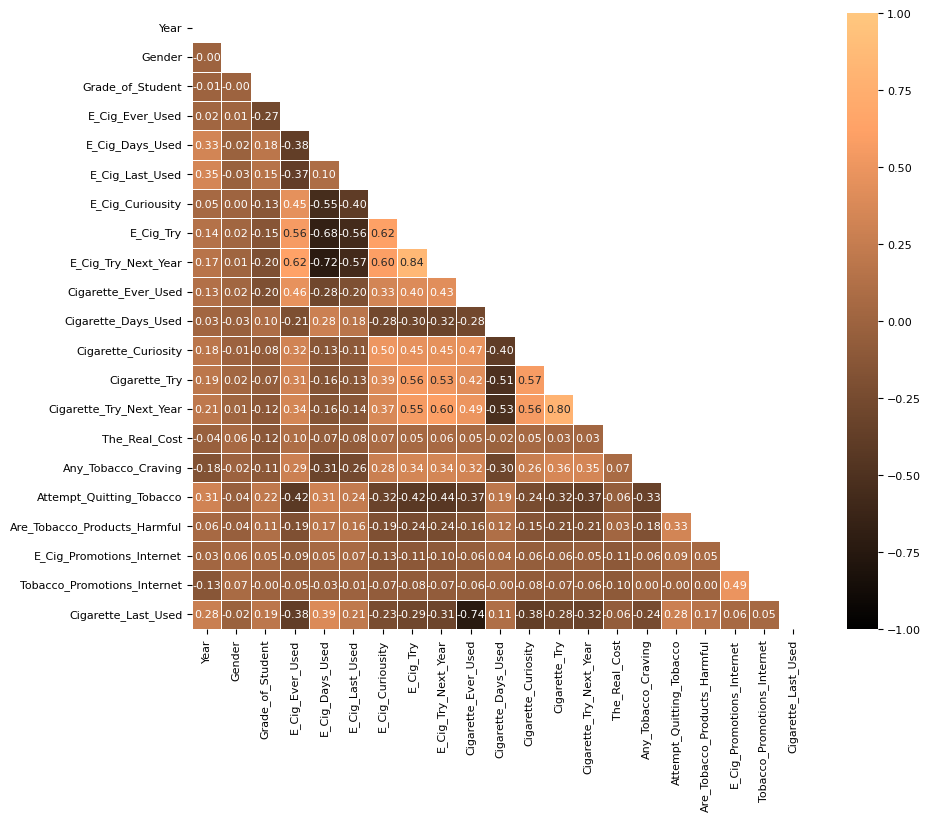

In [206]:
# creating the correlation matrix - Bhoomika
NYTSHeatmapData = NYTSNumbersdf.drop('Unnamed: 0', axis=1)
correlation_matrix = NYTSHeatmapData.corr()
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))


# Create the heatmap
plt.figure(figsize = (10,8))
plt.rcParams.update({'font.size': 8})
sns.heatmap(correlation_matrix, cmap = 'copper', vmin = -1, vmax = 1, center = 0,annot=True, 
            fmt=".2f", square=True, linewidths=.5, mask = mask)
plt.show()